# Installing libraries

In [36]:
!pip install -U pynwb --quiet
!pip install wget --quiet
!pip install pytorch-lightning --quiet

# Imports

In [37]:
import wget
import zipfile
import os
import numpy as np
import scipy.io.wavfile as wavfile
from scipy.stats import pearsonr
from sklearn.model_selection import KFold
from sklearn.decomposition import PCA
from sklearn.linear_model import LinearRegression
import torch
import torch.nn as nn
import torch.optim as optim
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch
from torch.utils.data import Dataset, DataLoader
import pandas as pd
from sklearn.model_selection import train_test_split
import torch.optim as optim
import os
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import scipy.io.wavfile as wavfile
from IPython.display import Audio, display

# Download and unpack data

In [38]:
wget.download("https://osf.io/download/g6q5m/", "SingleWordProductionDutch-iBIDS.zip")

'SingleWordProductionDutch-iBIDS.zip'

In [39]:
with zipfile.ZipFile('SingleWordProductionDutch-iBIDS.zip', 'r') as zip_ref:
  zip_ref.extractall()
os.remove('SingleWordProductionDutch-iBIDS.zip')

# Processing data

In [40]:
!wget https://raw.githubusercontent.com/eva-vision/2BRAINS/main/MelFilterBank.py --quiet
!wget https://raw.githubusercontent.com/eva-vision/2BRAINS/main/extract_features.py --quiet
!wget https://raw.githubusercontent.com/neuralinterfacinglab/SingleWordProductionDutch/main/reconstructWave.py --quiet

In [41]:
!python MelFilterBank.py
!python reconstructWave.py --quiet
!python extract_features.py

Traceback (most recent call last):
  File "/content/reconstructWave.py", line 55, in <module>
    (sr,wf) = wavefile.read('something.wav')
  File "/usr/local/lib/python3.10/dist-packages/scipy/io/wavfile.py", line 647, in read
    fid = open(filename, 'rb')
FileNotFoundError: [Errno 2] No such file or directory: 'something.wav'


In [42]:
import reconstructWave as rW
import MelFilterBank as mel

# Training

In [43]:
# Define the neural network architecture
class TimeSeriesNet(nn.Module):
    def __init__(self):
        super(TimeSeriesNet, self).__init__()

        # Input layer
        self.input = nn.Linear(1143, 512)

        # Hidden layers
        self.hidden1 = nn.Linear(512, 256)
        self.hidden2 = nn.Linear(256, 256)
        self.hidden3 = nn.Linear(256, 128)
        self.hidden4 = nn.Linear(128, 64)

        # Output layer
        self.output = nn.Linear(64, 23)

        # Batch normalization layers
        self.bn_input = nn.BatchNorm1d(512)
        self.bn_hidden1 = nn.BatchNorm1d(256)
        self.bn_hidden2 = nn.BatchNorm1d(256)
        self.bn_hidden3 = nn.BatchNorm1d(128)
        self.bn_hidden4 = nn.BatchNorm1d(64)

    def forward(self, x):
        # Input layer with activation and normalization
        x = F.relu(self.bn_input(self.input(x)))

        # Hidden layers with activation and normalization
        x = F.relu(self.bn_hidden1(self.hidden1(x)))
        x = F.relu(self.bn_hidden2(self.hidden2(x)))
        x = F.relu(self.bn_hidden3(self.hidden3(x)))
        x = F.relu(self.bn_hidden4(self.hidden4(x)))

        # Output layer
        x = self.output(x)
        return x

# Create an instance of the network
time_series_net = TimeSeriesNet()

In [44]:
feat_path = r'./features'
result_path = r'./results'
pt = 'sub-01'

In [45]:
data = np.load(os.path.join(feat_path,f'{pt}_feat.npy'))
spectrogram = np.load(os.path.join(feat_path,f'{pt}_spec.npy'))
X_train, X_test, y_train, y_test = train_test_split(data, spectrogram, test_size=0.20, random_state=42)

In [46]:
class TimeSeriesDataset(Dataset):
    def __init__(self):
        # Load data
        self.X = X_train
        self.y = y_train

    def __len__(self):
        return len(self.X)

    def __getitem__(self, idx):
        return torch.tensor(self.X[idx], dtype=torch.float32), torch.tensor(self.y[idx], dtype=torch.float32)

dataset = TimeSeriesDataset()

# Create data loader
dataloader = DataLoader(dataset, batch_size=32, shuffle=True)

In [47]:
# Define a loss function and optimizer
criterion = nn.MSELoss()  # Mean Squared Error Loss, common for regression tasks
optimizer = optim.Adam(time_series_net.parameters(), lr=0.001)  # Using Adam optimizer

# Function to train the network
def train_network(net, dataloader, epochs=5):
    net.train()  # Set the network into training mode

    for epoch in range(epochs):  # Loop over the dataset multiple times
        running_loss = 0.0

        for i, data in enumerate(dataloader, 0):
            # Get the inputs; data is a list of [inputs, labels]
            inputs, labels = data

            # Zero the parameter gradients
            optimizer.zero_grad()

            # Forward pass
            outputs = net(inputs)

            # Compute the loss
            loss = criterion(outputs, labels)

            # Backward pass and optimize
            loss.backward()
            optimizer.step()

            # Print statistics
            running_loss += loss.item()
            if i % 100 == 99:    # Print every 100 mini-batches
                print(f'Epoch {epoch + 1}, Batch {i + 1}, Loss: {running_loss / 100}')
                running_loss = 0.0

    print('Finished Training')

# Example usage
train_network(time_series_net, dataloader, epochs=5)

Epoch 1, Batch 100, Loss: 14.740900158882141
Epoch 1, Batch 200, Loss: 3.859570358991623
Epoch 1, Batch 300, Loss: 2.8776054763793946
Epoch 1, Batch 400, Loss: 2.621148145198822
Epoch 1, Batch 500, Loss: 2.3890308368206026
Epoch 1, Batch 600, Loss: 2.270977644920349
Epoch 1, Batch 700, Loss: 2.222761713266373
Epoch 2, Batch 100, Loss: 2.262492377758026
Epoch 2, Batch 200, Loss: 2.060842456817627
Epoch 2, Batch 300, Loss: 1.8976854765415192
Epoch 2, Batch 400, Loss: 1.9482959353923797
Epoch 2, Batch 500, Loss: 1.951657114624977
Epoch 2, Batch 600, Loss: 1.84287355363369
Epoch 2, Batch 700, Loss: 1.838785606622696
Epoch 3, Batch 100, Loss: 1.7314222431182862
Epoch 3, Batch 200, Loss: 1.7699966609477997
Epoch 3, Batch 300, Loss: 1.6811717110872268
Epoch 3, Batch 400, Loss: 1.7306410312652587
Epoch 3, Batch 500, Loss: 1.6401211053133011
Epoch 3, Batch 600, Loss: 1.6678354066610337
Epoch 3, Batch 700, Loss: 1.5759682279825211
Epoch 4, Batch 100, Loss: 1.4925498390197753
Epoch 4, Batch 200, 

# Prediction

In [48]:
def infer(net, input_data):
    net.eval()  # Set the network to evaluation mode

    with torch.no_grad():  # Turn off gradients for validation, saves memory and computations
        inputs = torch.tensor(input_data, dtype=torch.float32)

        # Check if the network is on a GPU and move the inputs to the same device
        if next(net.parameters()).is_cuda:
            inputs = inputs.to('cuda')

        outputs = net(inputs)
        return outputs

# Example usage
# input_data = [array of your new input data]  # Replace with your input data
predictions = infer(time_series_net, data)
print(predictions)

tensor([[4.4501, 5.4236, 5.3273,  ..., 4.0894, 4.0106, 2.6951],
        [4.3515, 5.2894, 5.1024,  ..., 3.9653, 3.8539, 2.5841],
        [4.1739, 5.0301, 4.7339,  ..., 3.7271, 3.6089, 2.3873],
        ...,
        [3.8750, 4.4924, 4.1790,  ..., 3.4439, 3.3450, 2.2463],
        [3.9548, 4.6158, 4.2898,  ..., 3.5091, 3.3951, 2.2566],
        [4.0397, 4.7508, 4.4397,  ..., 3.5891, 3.4619, 2.2839]])


In [49]:
predictions = np.array(predictions)

# Visualisation

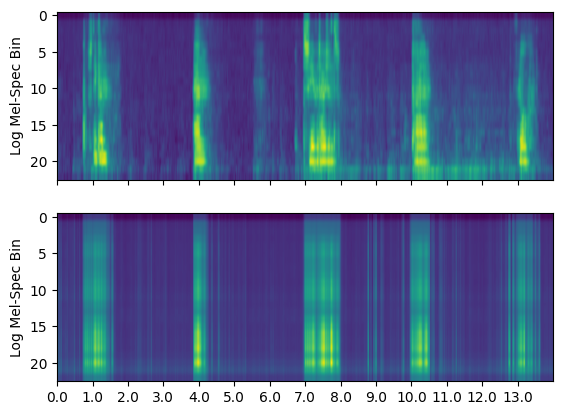

In [50]:
# Viz example spectrogram
#Which timeframe to plot
start_s = 5.5
stop_s = 19.5

frameshift = 0.01
#Load spectrograms
rec_spec = predictions
spectrogram = spectrogram
#Load prompted words
#eeg_sr= 1024
#words = np.load(os.path.join(feat_path,f'{participant}_procWords.npy'))[int(start_s*eeg_sr):int(stop_s*eeg_sr)]
#words = [words[w] for w in np.arange(1,len(words)) if words[w]!=words[w-1] and words[w]!='']

os.makedirs(os.path.join(result_path), exist_ok=True)

cm='viridis'
fig, ax = plt.subplots(2, sharex=True)
#Plot spectrograms
pSta=int(start_s*(1/frameshift));pSto=int(stop_s*(1/frameshift))
ax[0].imshow(np.flipud(spectrogram[pSta:pSto, :].T), cmap=cm, interpolation=None,aspect='auto')
ax[0].set_ylabel('Log Mel-Spec Bin')
ax[1].imshow(np.flipud(rec_spec[pSta:pSto, :].T), cmap=cm, interpolation=None,aspect='auto')
plt.setp(ax[1], xticks=np.arange(0,pSto-pSta,int(1/frameshift)), xticklabels=[str(x/int(1/frameshift)) for x in np.arange(0,pSto-pSta,int(1/frameshift))])
#plt.setp(ax[1], xticks=np.arange(int(1/frameshift),spectrogram[pSta:pSto, :].shape[0],3*int(1/frameshift)), xticklabels=words)
ax[1].set_ylabel('Log Mel-Spec Bin')

plt.savefig(os.path.join(result_path,'spec_example.png'),dpi=600)

#Saving for use in Adobe Illustrator
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
plt.savefig(os.path.join(result_path,'spec_example.pdf'),transparent=True)
plt.show()

# Audio output

In [51]:
def createAudio(spectrogram, audiosr=16000, winLength=0.05, frameshift=0.01):
  """
  Create a reconstructed audio wavefrom

  Parameters
  ----------
  spectrogram: array
  Spectrogram of the audio
  sr: int
  Sampling rate of the audio
  windowLength: float
  Length of window (in seconds) in which spectrogram was calculated
  frameshift: float
  Shift (in seconds) after which next window was extracted
  Returns
  ----------
  scaled: array
  Scaled audio waveform
  """
  mfb = mel.MelFilterBank(int((audiosr*winLength)/2+1), spectrogram.shape[1], audiosr)
  nfolds = 1
  hop = int(spectrogram.shape[0]/nfolds)
  rec_audio = np.array([])
  for_reconstruction = mfb.fromLogMels(spectrogram)
  for w in range(0,spectrogram.shape[0],hop):
    spec = for_reconstruction[w:min(w+hop,for_reconstruction.shape[0]),:]
  rec = rW.reconstructWavFromSpectrogram(spec,spec.shape[0]*spec.shape[1],fftsize=int(audiosr*winLength),overlap=int(winLength/frameshift))
  rec_audio = np.append(rec_audio,rec)
  scaled = np.int16(rec_audio/np.max(np.abs(rec_audio)) * 32767)
  return scaled

In [52]:
audiosr = 16000
winLength = 0.05
frameshift = 0.01
np.save(os.path.join(result_path,f'{pt}_predicted_spec.npy'), rec_spec)
#Synthesize waveform from spectrogram using Griffin-Lim
reconstructedWav = createAudio(predictions,audiosr=audiosr,winLength=winLength,frameshift=frameshift)
wavfile.write(os.path.join(result_path,f'{pt}_predicted.wav'),int(audiosr),reconstructedWav)

In [53]:
#For comparison synthesize the original spectrogram with Griffin-Lim
origWav = createAudio(spectrogram,audiosr=audiosr,winLength=winLength,frameshift=frameshift)
wavfile.write(os.path.join(result_path,f'{pt}_orig_synthesized.wav'),int(audiosr),origWav)

In [54]:
from IPython.display import Audio, display
print("Original synthesized\n")
display(Audio(os.path.join(result_path,f'{pt}_orig_synthesized.wav'), autoplay=False))
print("\nPredicted\n")
display(Audio(os.path.join(result_path,f'{pt}_predicted.wav'), autoplay=False))

Original synthesized




Predicted

